# <center>Food Classification using TensorFlow (CNN Transfer learning)</center>
<center><img src= "https://timesofindia.indiatimes.com/thumb/msid-77563051,width-1200,height-900,resizemode-4/.jpg" alt ="Titanic" style='width:500px;'></center><br>

- <h3> Image classification is the task of identifying images and categorizing them in one of several predefined distinct classes.</h3><br>
- <h3> Being one of the computer vision (CV) tasks, Image classification serves as the foundation for solving different CV problems such as object detection which further gets divided into semantic and instance segmentation.</h3><br>
- <h3> The leading architecture used for image recognition and detection tasks is Convolutional Neural Networks (CNNs). Convolutional neural networks consist of several layers with small neuron collections, each of them perceiving small parts of an image. </h3>

In [1]:
import os
import warnings
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt

warnings.filterwarnings("ignore")

In [2]:
import tensorflow as tf
import tensorflow.keras.backend as K
from tensorflow.keras.preprocessing import image
from tensorflow.keras import models
from tensorflow.keras.models import load_model
from tensorflow.keras import models
from PIL import Image 
from skimage.io import imread
import cv2

K.clear_session()

<h2> <span style="color:red"><b> CHALLENGES </b></span></h2><hr> <h3>1. Cleaning the dataset due to following :</h3>
    
- A lot of misspelled labels.<br>
- Overwhelming number of raw images not related to any class.<br>

<h3> 2. Training model without bias : </h3>

- Similarly looking items with common attributes (Fried samosa and pakode looks familiar.)<br>
- Multiple labels clashing together (Butter Naan and Dal Makhni in one picture, Samosa and Pakode, etc.)<br>
- Unwanted feature selection because of big architectures in transfer learning (Ketchup and green chutney is most common thing alongside pakode, samosa, kathi rolls and what not.)<br>

<hr>

<h2> <span style="color:green"> Finally after 4-5 hours of data cleaning and correcting labels, it was time for fun! </span> </h2>

# <b>IMAGE PROCESSSING</b>

<h2>Reshaping dimensions so we can start processing arrays. </h2>

In [3]:
img = plt.imread('../input/indian-food-classification/dataset/Dataset/train/pizza/033.jpg')
dims = np.shape(img)
matrix = np.reshape(img, (dims[0] * dims[1], dims[2]))
print(np.shape(matrix))

(680900, 3)


Image shape ->  (619, 1100)
Color channels ->  3
Min color depth : 0, Max color depth 255


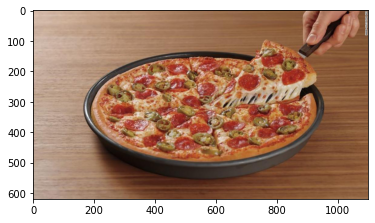

In [4]:
plt.imshow(img)
print("Image shape -> ",dims[:2])
print("Color channels -> ",dims[2])
print("Min color depth : {}, Max color depth {}".format(np.min(img),np.max(img)))

<h2>Plot for visualizing pixel intensities for RGB in color space</h2>

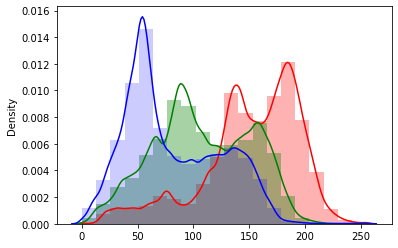

In [5]:
sns.distplot(matrix[:,0], bins=20,color="red",hist_kws=dict(alpha=0.3))
sns.distplot(matrix[:,1], bins=20,color="green",hist_kws=dict(alpha=0.35))
sns.distplot(matrix[:,2], bins=20,color="blue",hist_kws=dict(alpha=0.2))
plt.show()

<h2>Plot for visualizing histogram between 2 color channel</h2>

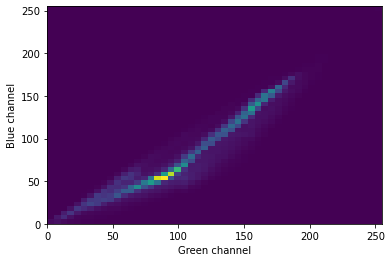

In [6]:
_ = plt.hist2d(matrix[:,1], matrix[:,2], bins=(50,50))
plt.xlabel('Green channel')
plt.ylabel('Blue channel')
plt.show()

- <span style="font-size:18px;color:blue"><b>The pixels between green and blue bands are correlated (as evident from overlapping on above graph), and typically has visible imagery.</b></span>

- <span style="font-size:18px;color:blue"><b>Raw band differences will need to be scaled or thresholded </b></span>

<span style="font-size:15px;"><b>Image data consists of variations due to resolution differences between scenes, pixel intensities of an image and the environment around which the image was taken. This area of image processing is critical in today's time with the rise of Artificial intelligence.From motion detection to complex circuits in self driving car, the research requires tremendous amount of work and can be seen as widely growing areas of computer vision.</b><span>

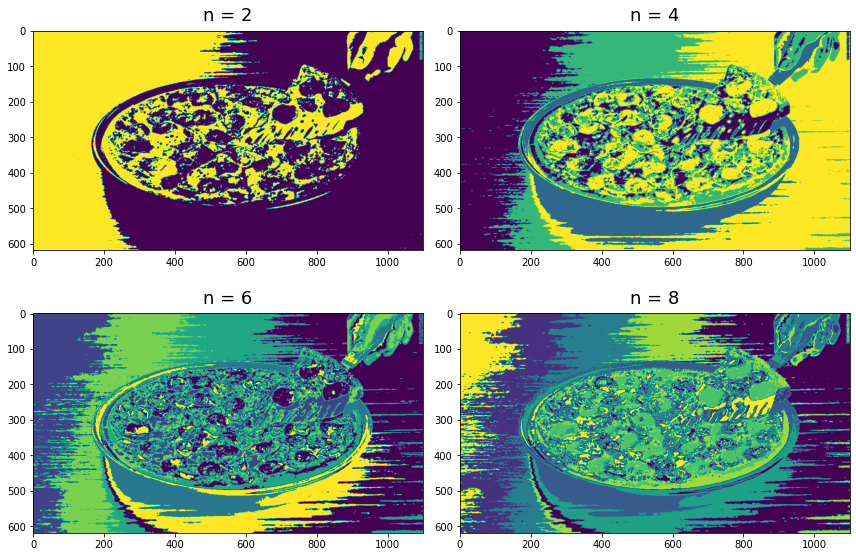

In [7]:
from sklearn import cluster
n_vals=[2,4,6,8]
plt.figure(1, figsize=(12, 8))

for subplot,n in enumerate(n_vals):
    kmeans=cluster.KMeans(n)
    clustered = kmeans.fit_predict(matrix)
    dims = np.shape(img)
    clustered_img = np.reshape(clustered, (dims[0], dims[1]))
    plt.subplot(2,2, subplot+1)
    plt.title("n = {}".format(n), pad = 10,size=18)
    plt.imshow(clustered_img)
    
plt.tight_layout()

<h2> Let's visualize the channel intensity for every cluster we just generated.</h2>

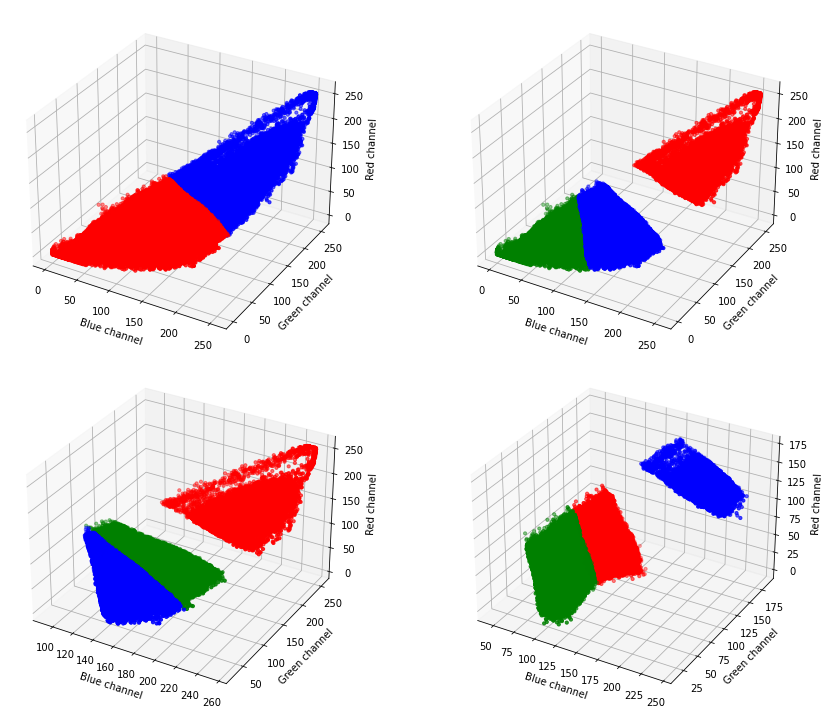

In [8]:
from mpl_toolkits.mplot3d import Axes3D

fig=plt.figure(figsize=(14,10))

ax = [fig.add_subplot(221, projection='3d'),
      fig.add_subplot(222, projection='3d'),
      fig.add_subplot(223, projection='3d'),
      fig.add_subplot(224, projection='3d')]

for plot_number,n in enumerate(n_vals):
    
    kmeans=cluster.KMeans(n)
    clustered = kmeans.fit_predict(matrix)
    x1, y1, z1 = [np.where(clustered == x)[0] for x in [0, 1, 2]]

    plot_vals = [('r', x1),
                 ('b', y1),
                 ('g', z1),
                 ]
    
    for c, channel in plot_vals:
        x = matrix[channel, 0]
        y = matrix[channel, 1]
        z = matrix[channel, 2]
        ax[plot_number].scatter(x, y, z, c=c,s=10)
    
    ax[plot_number].set_xlabel('Blue channel')
    ax[plot_number].set_ylabel('Green channel')
    ax[plot_number].set_zlabel('Red channel')

plt.tight_layout()

<center><span style="font-size:18px;color:blue"><b>It is evident from above graph, intensity is reduced in the color space as the number of clusters are increased.</b></span></center>

<h2> Brightness normalization is a process that changes the range of pixel intensity values. Applications include photographs with poor contrast due to glare, for example. Normalization is sometimes called contrast stretching or histogram stretching. </h2>

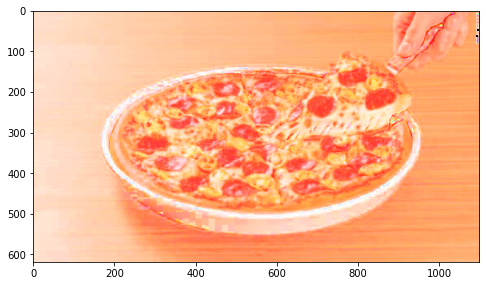

In [9]:
bnorm = np.zeros_like(matrix, dtype=np.float32)
max_range = np.max(matrix, axis=1)
bnorm = matrix / np.vstack((max_range, max_range, max_range)).T
bnorm_img = np.reshape(bnorm, (dims[0],dims[1],dims[2]))
plt.figure(figsize=(8,10))
plt.imshow(bnorm_img)
plt.show()

 <h2> Sobel filter is a basic way to get an edge magnitude/gradient image. </h2>
    
**It works by calculating the gradient of image intensity at each pixel within the image. It finds the direction of the largest increase from light to dark and the rate of change in that direction.**

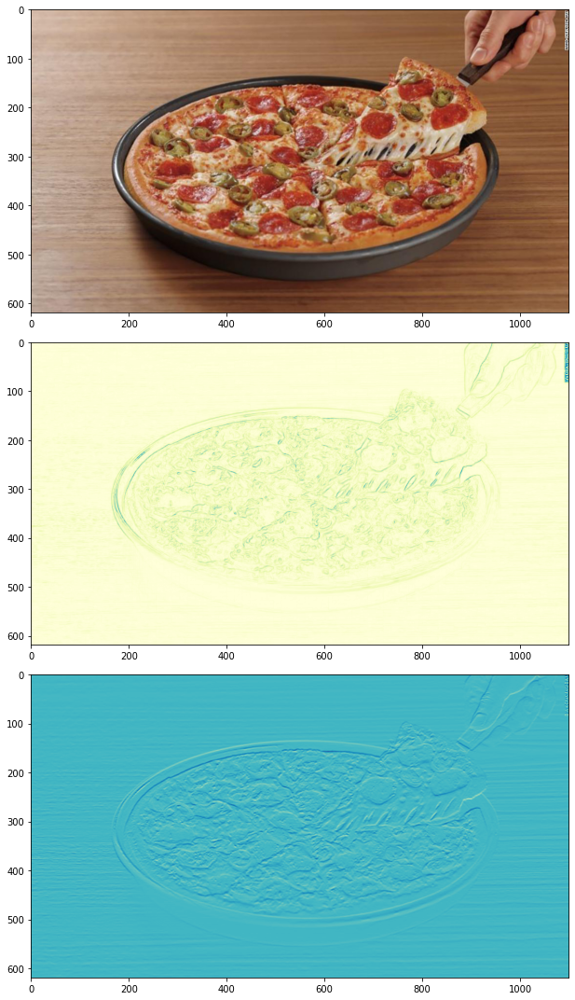

In [10]:
import skimage
from skimage.feature import greycomatrix, greycoprops
from skimage.filters import sobel
from skimage.filters import sobel_h

plt.figure(1,figsize=(20,15))
cmap="YlGnBu"
plt.subplot(3,1,1)
plt.imshow(img)

plt.subplot(3,1,2)
plt.imshow(sobel(img[:,:,2]),cmap=cmap)

plt.subplot(3,1,3)
plt.imshow(sobel_h(img[:,:,1]), cmap=cmap)

plt.tight_layout()

<center><span style="font-size:18px;color:blue"><b>Clearly the results are fascinating. We are able to isolate object and detect the edge. </b></span></center>

<h2> Let's apply Principal Component Analysis. It is a linear dimensionality reduction technique that can be utilized for extracting information from a high-dimensional space by projecting it into a lower-dimensional sub-space.</h2>

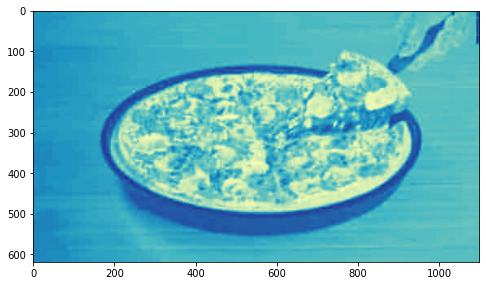

In [11]:
from sklearn.decomposition import PCA

pca = PCA(3)
pca.fit(matrix)
img_pca = pca.transform(matrix)
img_pca = np.reshape(img_pca, (dims[0], dims[1], dims[2]))

fig = plt.figure(figsize=(8, 8))
plt.imshow(img_pca[:,:,1], cmap=cmap)

# <b>Exploratory Data Analysis (EDA)</b>

## Let's visualize number of training examples for each food item

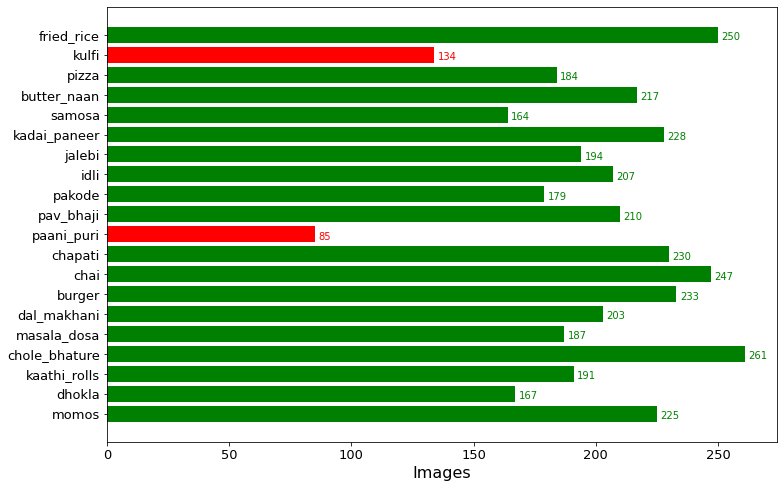

In [12]:
main='../input/indian-food-classification/dataset/Dataset/train/'

data=dict()

for i in os.listdir(main):
    sub_dir=os.path.join(main,i)
    count=len(os.listdir(sub_dir))
    data[i]=count
    
  
keys = data.keys()
values = data.values()

colors=["red" if x<= 150 else "green" for x in values]

fig, ax = plt.subplots(figsize=(12,8))
y_pos=np.arange(len(values))
plt.barh(y_pos,values,align='center',color=colors)
for i, v in enumerate(values):
    ax.text(v+1.4, i-0.25, str(v), color=colors[i])
ax.set_yticks(y_pos)
ax.set_yticklabels(keys)
ax.set_xlabel('Images',fontsize=16)
plt.xticks(color='black',fontsize=13)
plt.yticks(fontsize=13)
plt.show()

<h3>We notice that 2 classes (Pani puri and Kulfi) lacks behind with training data.</h3>

> - <span style="font-size:18px;color:blue">Data augmentation helps with classes not having enough training examples by increasing the amount of relevant data in the dataset.</span>
<br><br>
> - <span style="font-size:18px;color:blue"> We would be doing what is known as **offline augmentation**. It works on relatively smaller datasets, by increasing the size of the dataset by a factor equal to the number of transformations you perform. (For example, by flipping all my images, it would increase the size of the dataset by a factor of 2).</span>
<br><br>
> - <span style="font-size:18px;color:blue"><u>You will get more clarity in the coming section</u></span>

## Let's visualize our dataset by randomly picking an image from every class

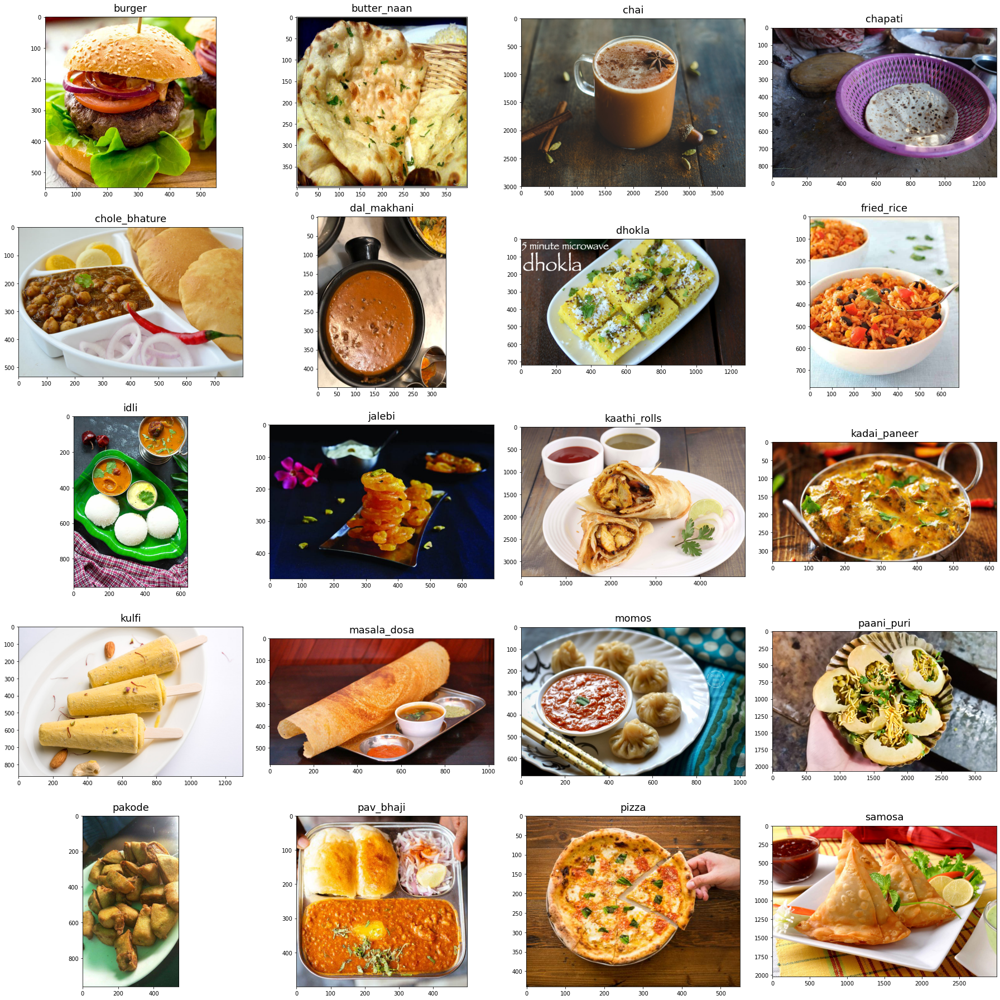

In [13]:
import random

train_folder = "/kaggle/input/indian-food-classification/dataset/Dataset/train"
images = []

for food_folder in sorted(os.listdir(train_folder)):
    food_items = os.listdir(train_folder + '/' + food_folder)
    food_selected = np.random.choice(food_items)
    images.append(os.path.join(train_folder,food_folder,food_selected))
                                     
fig=plt.figure(1, figsize=(25, 25))

for subplot,image_ in enumerate(images):
    category=image_.split('/')[-2]
    imgs = plt.imread(image_)
    a,b,c=imgs.shape
    fig=plt.subplot(5, 4, subplot+1)
    fig.set_title(category, pad = 10,size=18)
    plt.imshow(imgs)
    
plt.tight_layout()

<hr>

## We discussed Data Augmentation before. Let's see how it works:
<span style="font-size:16px"> 1. Accepting a batch of images used for training.</span>

<span style="font-size:16px"> 2. Taking this batch and applying a series of random transformations to each image in the batch. (including random rotation, resizing, shearing, etc.)</span>

<span style="font-size:16px"> 3. Replacing the original batch with the new, randomly transformed batch.</span>

<span style="font-size:16px"> 4. Training the CNN on this randomly transformed batch. (i.e, the original data itself is not used for training)</span>

<center><img src="https://miro.medium.com/max/1700/1*ae1tW5ngf1zhPRyh7aaM1Q.png" width=500></center>

<hr>

# <b> MODEL TRAINING </b>

In [14]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

n_classes = 20
batch_size = 32
img_width, img_height = 299, 299

train_data_dir = '/kaggle/input/indian-food-classification/dataset/Dataset/train'

# Data Augmentation with ImageDataGenerator
train_datagen = ImageDataGenerator(
    rescale=1. / 255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)

train_generator = train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical')

val_data_dir = '/kaggle/input/indian-food-classification/dataset/Dataset/val'

val_datagen = ImageDataGenerator(rescale=1. / 255)

val_generator = val_datagen.flow_from_directory(
    val_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical')

Found 3996 images belonging to 20 classes.
Found 1250 images belonging to 20 classes.


In [15]:
class_map = train_generator.class_indices
class_map

{'burger': 0,
 'butter_naan': 1,
 'chai': 2,
 'chapati': 3,
 'chole_bhature': 4,
 'dal_makhani': 5,
 'dhokla': 6,
 'fried_rice': 7,
 'idli': 8,
 'jalebi': 9,
 'kaathi_rolls': 10,
 'kadai_paneer': 11,
 'kulfi': 12,
 'masala_dosa': 13,
 'momos': 14,
 'paani_puri': 15,
 'pakode': 16,
 'pav_bhaji': 17,
 'pizza': 18,
 'samosa': 19}

In [16]:
# print(tf.__version__)
# print(tf.test.gpu_device_name())

## Training the model

In [17]:
from tensorflow.keras.applications.inception_v3 import InceptionV3
# from tensorflow.keras.layers import Convolution2D, MaxPooling2D, ZeroPadding2D, GlobalAveragePooling2D, AveragePooling2D
# from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten

from tensorflow.keras.layers import GlobalAveragePooling2D
from tensorflow.keras.layers import Dense, Dropout

from tensorflow.keras import regularizers
from tensorflow.keras.regularizers import l2

from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.callbacks import ModelCheckpoint, CSVLogger

nb_train_samples = 3583 
nb_validation_samples = 1089

inception = InceptionV3(weights='imagenet', include_top=False)
x = inception.output
x = GlobalAveragePooling2D()(x)
x = Dense(128,activation='relu')(x)
x = Dropout(0.2)(x)

predictions = Dense(n_classes,kernel_regularizer=regularizers.l2(0.005), activation='softmax')(x)

model = Model(inputs=inception.input, outputs=predictions)
model.compile(optimizer=SGD(lr=0.0001, momentum=0.9), loss='categorical_crossentropy', metrics=['accuracy'])
checkpointer = ModelCheckpoint(filepath='v1_inceptionV3', verbose=1, save_best_only=True)
csv_logger = CSVLogger('history_v1_inceptionV3.log')

history = model.fit_generator(train_generator,
                    steps_per_epoch = nb_train_samples // batch_size,
                    validation_data=val_generator,
                    validation_steps=nb_validation_samples // batch_size,
                    epochs=20,
                    verbose=1,
                    callbacks=[csv_logger, checkpointer])

87916544/87910968 [==============================] - 1s 0us/step
Epoch 1/20
111/111 [==============================] - 242s 2s/step - loss: 3.2211 - accuracy: 0.0722 - val_loss: 2.9879 - val_accuracy: 0.1765

Epoch 00001: val_loss improved from inf to 2.98788, saving model to v1_inceptionV3
Epoch 2/20
111/111 [==============================] - 181s 2s/step - loss: 2.9726 - accuracy: 0.1965 - val_loss: 2.7686 - val_accuracy: 0.3539

Epoch 00002: val_loss improved from 2.98788 to 2.76860, saving model to v1_inceptionV3
Epoch 3/20
111/111 [==============================] - 171s 2s/step - loss: 2.7097 - accuracy: 0.3437 - val_loss: 2.4899 - val_accuracy: 0.5055

Epoch 00003: val_loss improved from 2.76860 to 2.48990, saving model to v1_inceptionV3
Epoch 4/20
111/111 [==============================] - 168s 2s/step - loss: 2.4608 - accuracy: 0.4496 - val_loss: 2.1992 - val_accuracy: 0.5827

Epoch 00004: val_loss improved from 2.48990 to 2.19915, saving model to v1_inceptionV3
Epoch 5/20
111/

## Saving the model

In [18]:
model.save('model_v1_inceptionV3.h5')

## Accuracy and Loss curves

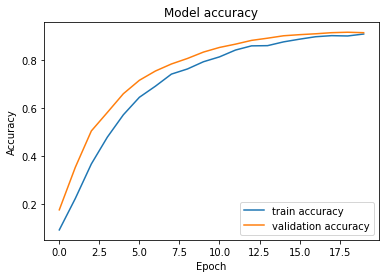

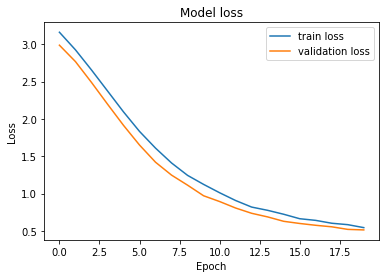

In [19]:
def plot_accuracy(history):
    
    plt.plot(history.history['accuracy'],label='train accuracy')
    plt.plot(history.history['val_accuracy'],label='validation accuracy')
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(loc='best')
    plt.savefig('Accuracy_v1_InceptionV3')
    plt.show()
    
def plot_loss(history):
    
    plt.plot(history.history['loss'],label="train loss")
    plt.plot(history.history['val_loss'],label="validation loss")
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='best')
    plt.savefig('Loss_v1_InceptionV3')
    plt.show()
    
plot_accuracy(history)
plot_loss(history)

# <b> PREDICTIONS </b>

## Load the model

In [20]:
K.clear_session()
path_to_model='./model_v1_inceptionV3.h5'
print("Loading the model..")
model = load_model(path_to_model)
print("Done!")

Loading the model..
Done!


## Testing model on test set 

In [21]:
test_data_dir = '../input/indian-food-classification/test'

test_datagen = ImageDataGenerator(rescale=1. / 255)

test_generator = test_datagen.flow_from_directory(
    test_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical')

Found 585 images belonging to 20 classes.


In [22]:
scores = model.evaluate_generator(test_generator)

print("Test Accuracy: {:.3f}".format(scores[1]))

Test Accuracy: 0.839


## Function to predict single image or predict all images from a directory

In [23]:
category={
    0: ['burger','Burger'], 1: ['butter_naan','Butter Naan'], 2: ['chai','Chai'],
    3: ['chapati','Chapati'], 4: ['chole_bhature','Chole Bhature'], 5: ['dal_makhani','Dal Makhani'],
    6: ['dhokla','Dhokla'], 7: ['fried_rice','Fried Rice'], 8: ['idli','Idli'], 9: ['jalegi','Jalebi'],
    10: ['kathi_rolls','Kaathi Rolls'], 11: ['kadai_paneer','Kadai Paneer'], 12: ['kulfi','Kulfi'],
    13: ['masala_dosa','Masala Dosa'], 14: ['momos','Momos'], 15: ['paani_puri','Paani Puri'],
    16: ['pakode','Pakode'], 17: ['pav_bhaji','Pav Bhaji'], 18: ['pizza','Pizza'], 19: ['samosa','Samosa']
}

def predict_image(filename,model):
    img_ = image.load_img(filename, target_size=(299, 299))
    img_array = image.img_to_array(img_)
    img_processed = np.expand_dims(img_array, axis=0) 
    img_processed /= 255.   
    
    prediction = model.predict(img_processed)
    
    index = np.argmax(prediction)
    
    plt.title("Prediction - {}".format(category[index][1]))
    plt.imshow(img_array)
    
def predict_dir(filedir,model):
    cols=5
    pos=0
    images=[]
    total_images=len(os.listdir(filedir))
    rows=total_images//cols + 1
    
    true=filedir.split('/')[-1]
    
    fig=plt.figure(1, figsize=(25, 25))
    
    for i in sorted(os.listdir(filedir)):
        images.append(os.path.join(filedir,i))
        
    for subplot,imggg in enumerate(images):
        img_ = image.load_img(imggg, target_size=(299, 299))
        img_array = image.img_to_array(img_)
        
        img_processed = np.expand_dims(img_array, axis=0) 

        img_processed /= 255.
        prediction = model.predict(img_processed)
        index = np.argmax(prediction)
        
        pred=category.get(index)[0]
        if pred==true:
            pos+=1
        
        fig=plt.subplot(rows, cols, subplot+1)
        fig.set_title(category.get(index)[1], pad = 10,size=18)
        plt.imshow(img_array)

    acc=pos/total_images
    print("Accuracy of Test : {:.2f} ({pos}/{total})".format(acc,pos=pos,total=total_images))
    plt.tight_layout()

- <h3> Single image prediction </h3>

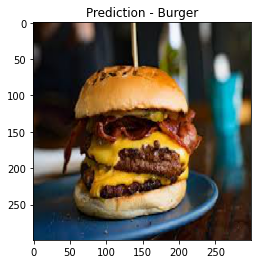

In [24]:
predict_image('../input/indian-food-classification/test/burger/images (16).jpg',model)

- <h3> Predicting category </h3>

Accuracy of Test : 0.93 (27/29)


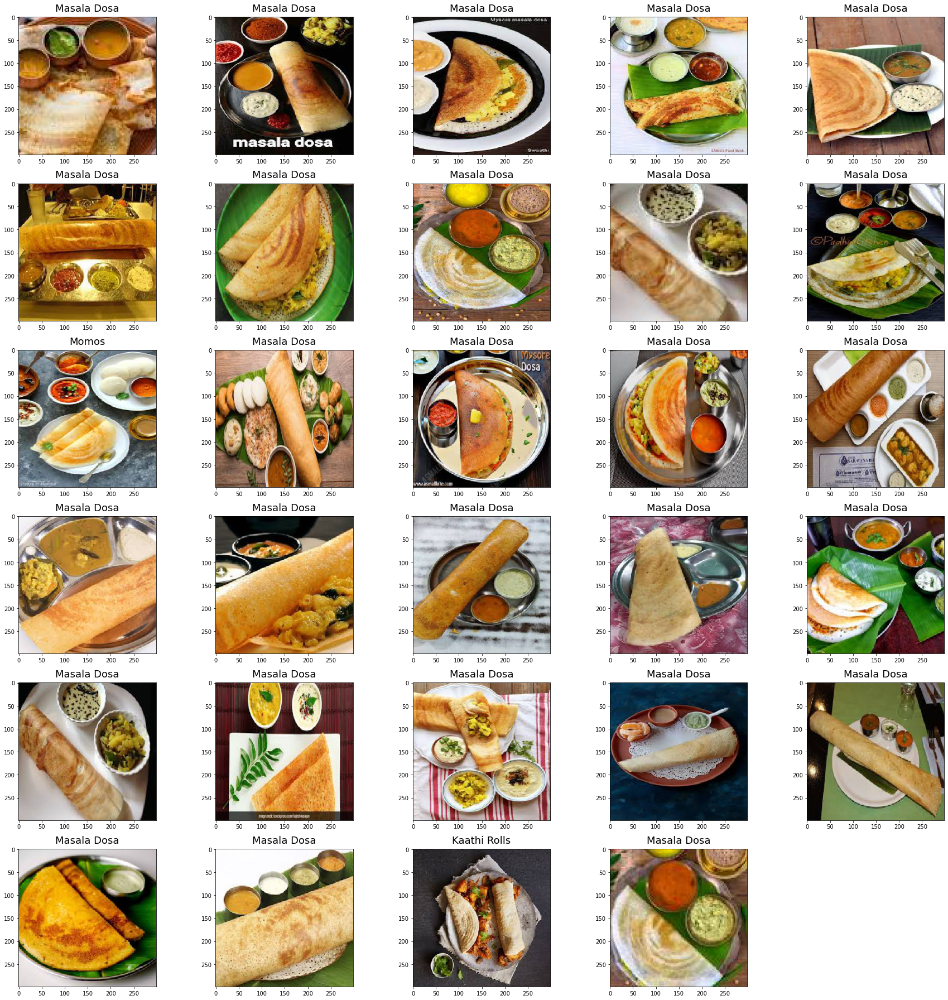

In [25]:
predict_dir("../input/indian-food-classification/test/masala_dosa",model)

## Let's plot a confusion matrix for all the food items

In [26]:
from sklearn.metrics import confusion_matrix
import itertools

img_width, img_height = 299, 299

def labels_confusion_matrix():
    folder_path="../input/indian-food-classification/test"
    
    mapping={}
    for i,j in enumerate(sorted(os.listdir(folder_path))):
        mapping[j]=i
    
    files=[]
    real=[]
    predicted=[]

    for i in os.listdir(folder_path):
        
        true=os.path.join(folder_path,i)
        true=true.split('/')[-1]
        true=mapping[true]
        
        for j in os.listdir(os.path.join(folder_path,i)):
            
            img_ = image.load_img(os.path.join(folder_path,i,j), target_size=(img_height, img_width))
            img_array = image.img_to_array(img_)
            img_processed = np.expand_dims(img_array, axis=0) 
            img_processed /= 255.
            prediction = model.predict(img_processed)
            index = np.argmax(prediction)

            predicted.append(index)
            real.append(true)
            
    return (real,predicted)

def print_confusion_matrix(real,predicted):

    cmap="viridis"
    cm_plot_labels = [i for i in range(20)]

    cm = confusion_matrix(y_true=real, y_pred=predicted)
    df_cm = pd.DataFrame(cm,cm_plot_labels,cm_plot_labels)
    sns.set(font_scale=1.1) # for label size
    plt.figure(figsize = (15,10))
    s=sns.heatmap(df_cm, annot=True,cmap=cmap) # font size
#     bottom,top=s.get_ylim()
#     s.set_ylim(bottom+0.6,top-0.6)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.savefig('confusion_matrix.png')
    plt.show()

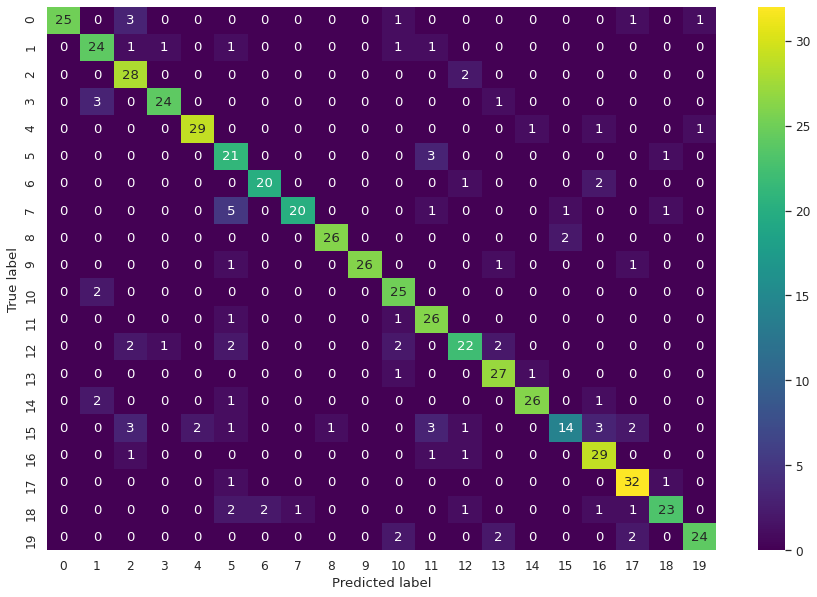

In [27]:
y_true,y_pred=labels_confusion_matrix()
print_confusion_matrix(y_true,y_pred)

<span style="font-size:21px;color:blue"><b>So far, So good!</b></span>
<hr>

<h1> <b> MODEL LEARNING VISUALIZATIONS </b></h1>

### SOME HELPER FUNCTIONS WHICH WILL ENABLE US TO VISUALIZE HOW NEURAL NETWORK WORKS AND PERFORMS!

In [28]:
def get_activations(img, model_activations):
    img = image.load_img(img, target_size=(299, 299))
    img = image.img_to_array(img)                    
    img = np.expand_dims(img, axis=0)         
    img /= 255. 
    plt.imshow(img[0])
    plt.show()
    return model_activations.predict(img)

def show_activations(activations, layer_names):
    
    images_per_row = 16

    # Now let's display our feature maps
    for layer_name, layer_activation in zip(layer_names, activations):
        # This is the number of features in the feature map
        n_features = layer_activation.shape[-1]

        # The feature map has shape (1, size, size, n_features)
        size = layer_activation.shape[1]

        # We will tile the activation channels in this matrix
        n_cols = n_features // images_per_row
        display_grid = np.zeros((size * n_cols, images_per_row * size))

        # We'll tile each filter into this big horizontal grid
        for col in range(n_cols):
            for row in range(images_per_row):
                channel_image = layer_activation[0,:, :,col * images_per_row + row]
                # Post-process the feature to make it visually palatable
                channel_image -= channel_image.mean()
                channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
                channel_image = np.clip(channel_image, 0, 255).astype('uint8')
                display_grid[col * size : (col + 1) * size,row * size : (row + 1) * size] = channel_image

        # Display the grid
        scale = 1. / size
        plt.figure(figsize=(scale * display_grid.shape[1],
                            scale * display_grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.imshow(display_grid, aspect='auto', cmap='viridis')

    plt.show()
    
def activation_conv():
    first_convlayer_activation = activations[0]
    second_convlayer_activation = activations[3]
    third_convlayer_activation = activations[6]
    f,ax = plt.subplots(1,3, figsize=(10,10))
    ax[0].imshow(first_convlayer_activation[0, :, :, 3], cmap='viridis')
    ax[0].axis('OFF')
    ax[0].set_title('Conv2d_1')
    ax[1].imshow(second_convlayer_activation[0, :, :, 3], cmap='viridis')
    ax[1].axis('OFF')
    ax[1].set_title('Conv2d_2')
    ax[2].imshow(third_convlayer_activation[0, :, :, 3], cmap='viridis')
    ax[2].axis('OFF')
    ax[2].set_title('Conv2d_3')
    
    
def get_attribution(food):
    
    tf.compat.v1.disable_eager_execution()
    
    img = image.load_img(food, target_size=(299, 299))
    img = image.img_to_array(img) 
    img /= 255. 
    f,ax = plt.subplots(1,3, figsize=(15,15))
    ax[0].imshow(img)
    
    img = np.expand_dims(img, axis=0)
    model = load_model('./model_v1_inceptionV3.h5')
        
    preds = model.predict(img)
    class_id = np.argmax(preds[0])
    ax[0].set_title("Input Image")
    class_output = model.output[:, class_id]
    last_conv_layer = model.get_layer("mixed10")
    
    grads = K.gradients(class_output, last_conv_layer.output)[0]
    pooled_grads = K.mean(grads, axis=(0, 1, 2))
    iterate = K.function([model.input], [pooled_grads, last_conv_layer.output[0]])
    pooled_grads_value, conv_layer_output_value = iterate([img])
    for i in range(2048):
        conv_layer_output_value[:, :, i] *= pooled_grads_value[i]
    
    heatmap = np.mean(conv_layer_output_value, axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)
    ax[1].imshow(heatmap)
    ax[1].set_title("Heat map")
    
    
    act_img = cv2.imread(food)
    heatmap = cv2.resize(heatmap, (act_img.shape[1], act_img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed = cv2.addWeighted(act_img, 0.6, heatmap, 0.4, 0)
    cv2.imwrite('classactivation.png', superimposed)
    img_act = image.load_img('classactivation.png', target_size=(299, 299))
    ax[2].imshow(img_act)
    ax[2].set_title("Class Activation")
    plt.show()
    return preds

## MODEL LAYERS 

In [29]:
print("Total layers in the model : ",len(model.layers),"\n")

# We start with index 1 instead of 0, as input layer is at index 0
layers = [layer.output for layer in model.layers[1:11]]
# We now initialize a model which takes an input and outputs the above chosen layers
activations_output = models.Model(inputs=model.input, outputs=layers)
# print(layers)

layer_names = []
for layer in model.layers[1:11]: 
    layer_names.append(layer.name)
    
print("First 10 layers which we can visualize are -> ", layer_names)


Total layers in the model :  315 

First 10 layers which we can visualize are ->  ['conv2d', 'batch_normalization', 'activation', 'conv2d_1', 'batch_normalization_1', 'activation_1', 'conv2d_2', 'batch_normalization_2', 'activation_2', 'max_pooling2d']


<span style="font-size:18px;color:blue"><b>Our model has 315 layers with InceptionV3 architecture!</b></span>
<br><br>
<span style="font-size:18px;color:blue"><b>Whoa! That's a lot to process at first, so let's just stick with 10 layers for now and visualize these first to see how neural networks classify.</b></span>
<hr>

# <b>LAYER WISE ACTIVATIONS</b>

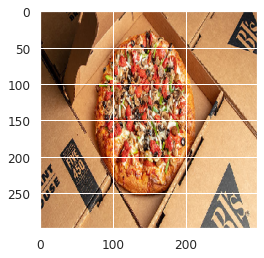

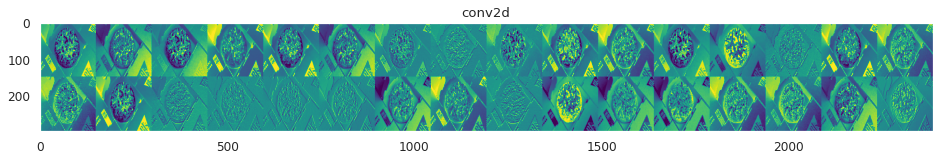

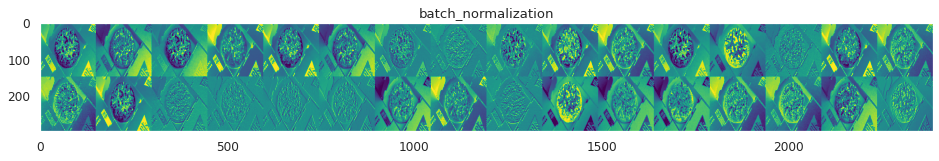

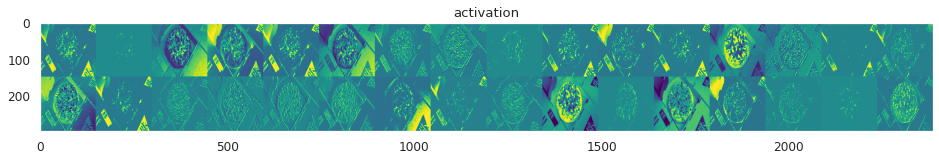

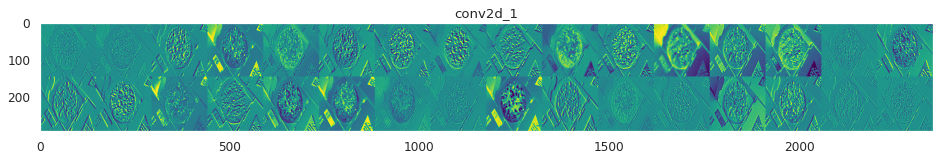

...

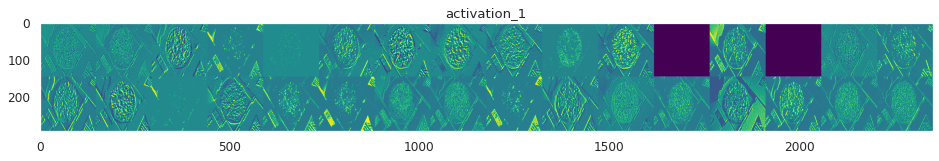

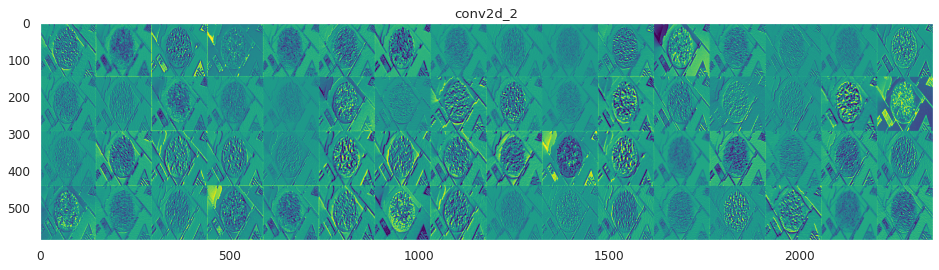

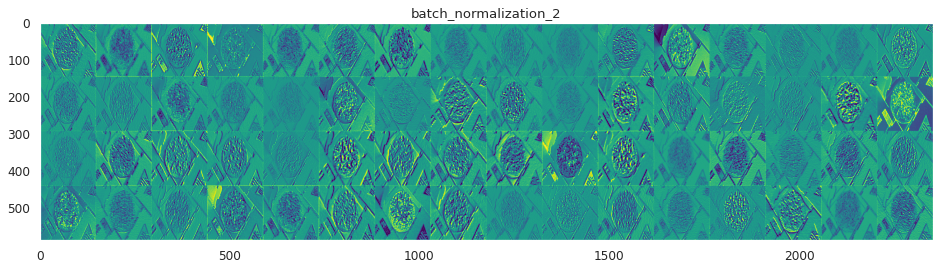

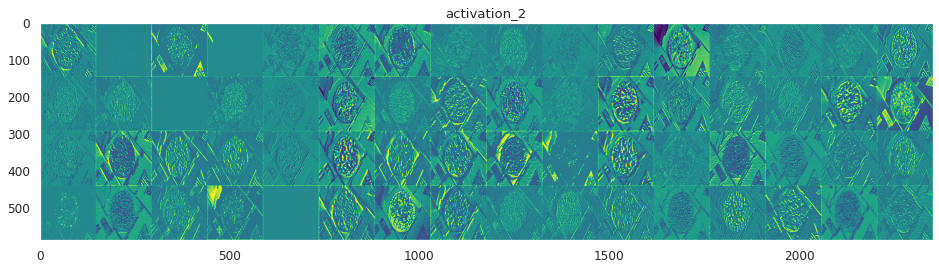

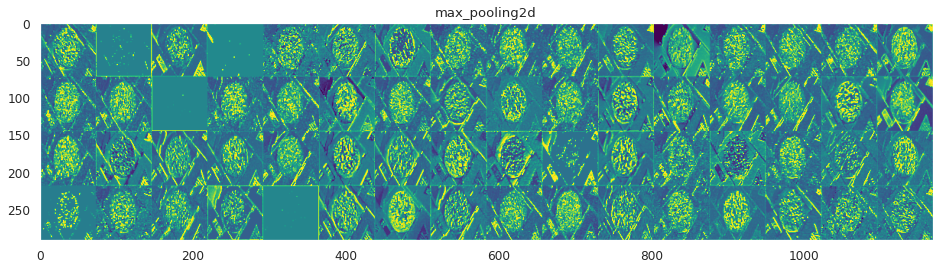

In [30]:
food = '../input/indian-food-classification/dataset/Dataset/val/pizza/155.jpg'
activations = get_activations(food,activations_output)
show_activations(activations, layer_names)

## Let's show the activation outputs of Conv2D layer (we have three of them in first 10 layers) to compare how layers get abstract with depth.

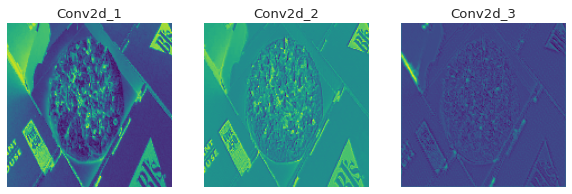

In [31]:
activation_conv()

## This time let's visualize some other food item's layer.

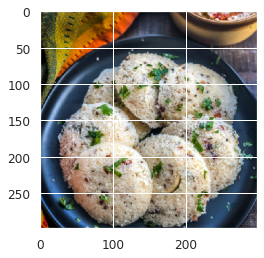

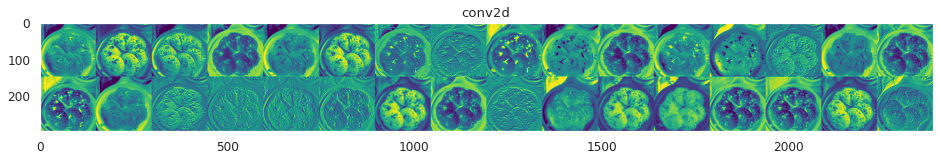

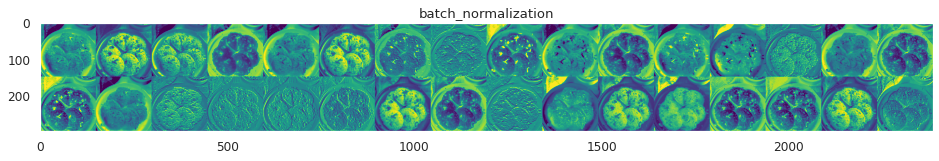

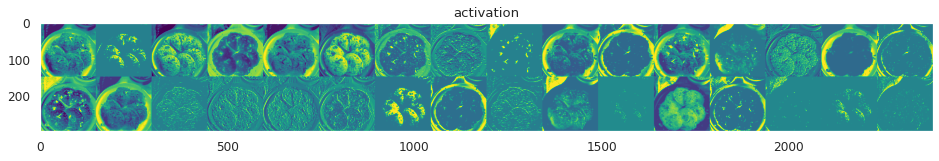

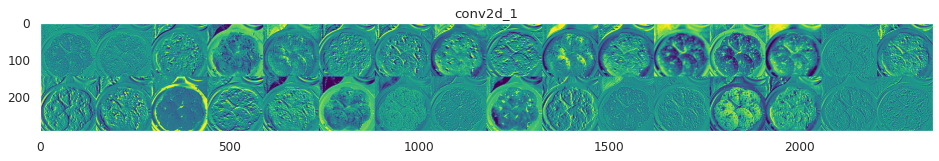

...

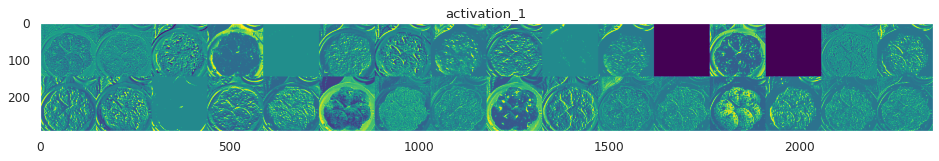

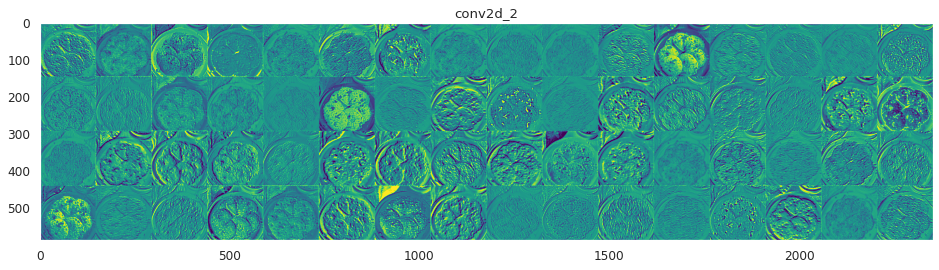

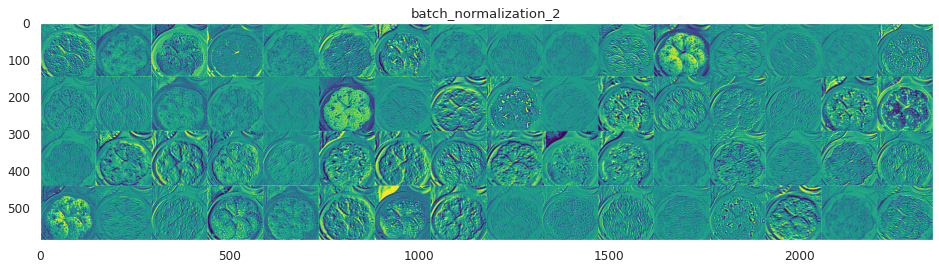

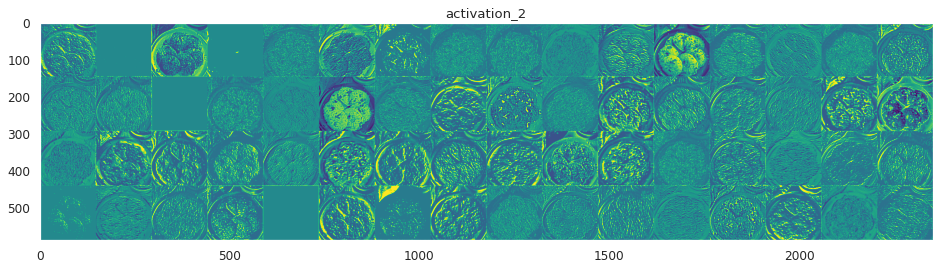

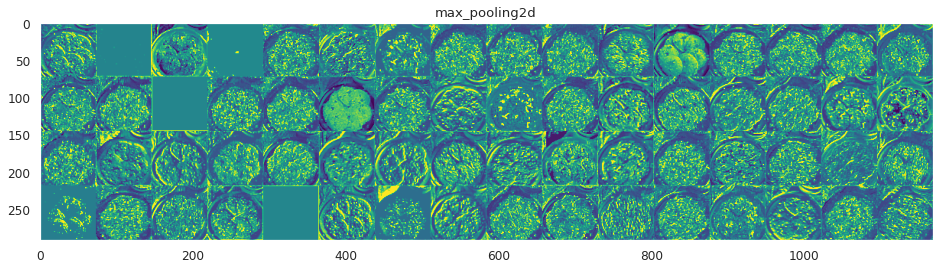

In [32]:
food = '../input/indian-food-classification/dataset/Dataset/val/idli/065.jpg'
activations = get_activations(food,activations_output)
show_activations(activations, layer_names)

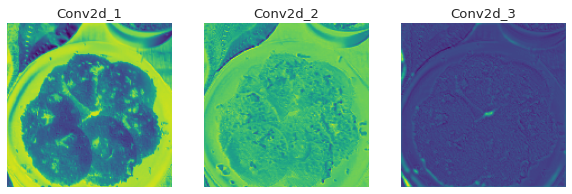

In [33]:
activation_conv()

<h2><span style="color:blue">NOW THIS IS WHERE THINGS WILL GET INTERESTING!</span></h2>

- <span style="font-size:17px;"> So far we were doing activation maps visualization which helped us understand how the input is transformed from one layer to another as it goes through several operations. </span>

- <span style="font-size:17px;"> At the end of training, we want the model to classify or detect objects based on features which are specific to the class.</span>

- <span style="font-size:17px;"> To validate how model attributes the features to class output, we can generate heat maps using gradients to find out which regions in the input images were instrumental in determining the class. </span>

# <b>GENERATING HEATMAPS</b>

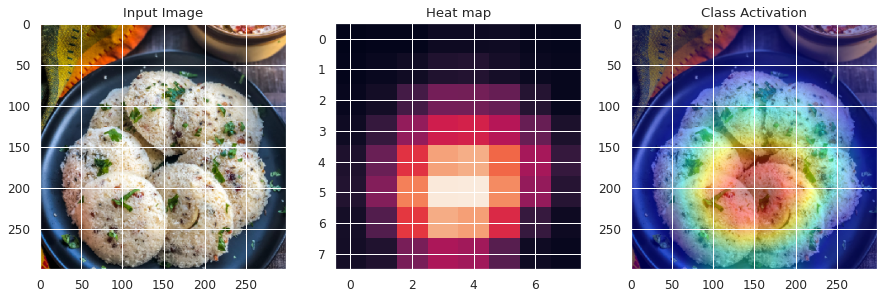

In [34]:
pred = get_attribution('../input/indian-food-classification/dataset/Dataset/val/idli/065.jpg')

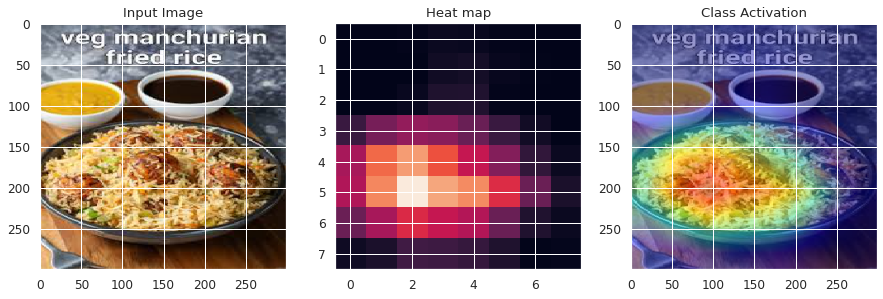

In [35]:
pred2=get_attribution('../input/indian-food-classification/test/fried_rice/images (5).jpg')

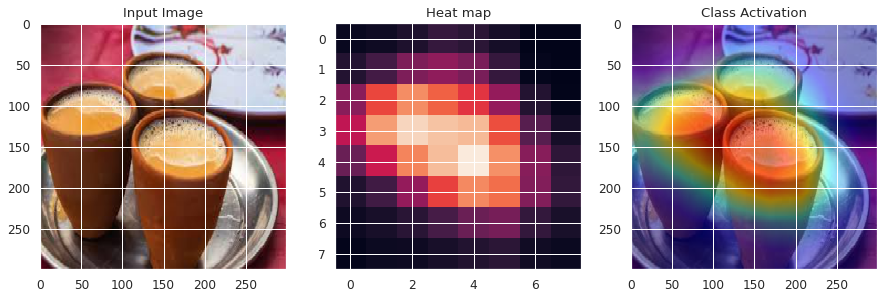

In [36]:
pred3=get_attribution('../input/indian-food-classification/test/chai/images (3).jpg')

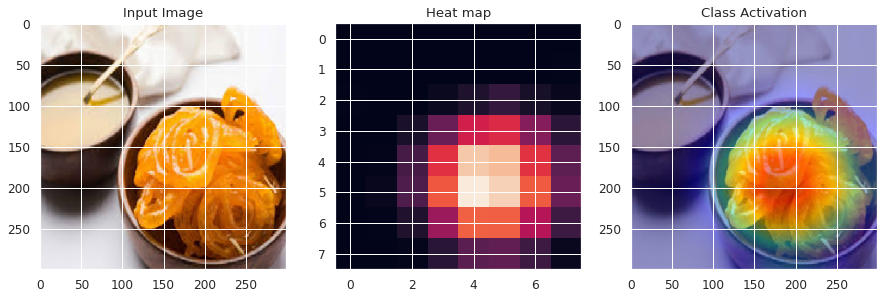

In [37]:
pred4=get_attribution('../input/indian-food-classification/test/jalebi/images (4).jpg')

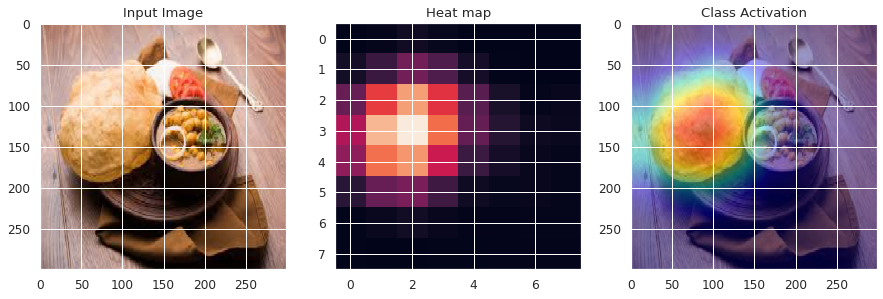

In [38]:
pred5=get_attribution('../input/indian-food-classification/test/chole_bhature/images (10).jpg')

<h2><span style="color:green">WOW! WE DID IT!</span></h2>
<hr></hr>
<ol>
    <h3>
        <li>In the above plot, we see on left the input image passed to the model, heat map in the middle and the class activation map on right</li><br>
        <li>Heat map gives a visual of what regions in the image were used in determining the class of the image</li><br>
        <li>Now it's clearly visible what a model looks for in an image if it has to be classified as an idli!</li>
    </h3>
</ol>

## Downloading random image from net to predict and generate heatmap

In [39]:
!wget -O download.jpg https://www.cookwithmanali.com/wp-content/uploads/2015/01/Restaurant-Style-Dal-Makhani-Recipe.jpg
    
model_load = load_model('./model_v1_inceptionV3.h5')

--2021-06-02 17:45:32--  https://www.cookwithmanali.com/wp-content/uploads/2015/01/Restaurant-Style-Dal-Makhani-Recipe.jpg
Resolving www.cookwithmanali.com (www.cookwithmanali.com)... 104.22.45.178, 104.22.44.178, 172.67.41.67, ...
Connecting to www.cookwithmanali.com (www.cookwithmanali.com)|104.22.45.178|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 164040 (160K) [image/jpeg]
Saving to: ‘download.jpg’

download.jpg        100%[===================>] 160.20K  --.-KB/s    in 0.02s   

2021-06-02 17:45:32 (9.52 MB/s) - ‘download.jpg’ saved [164040/164040]



<span style="font-size:16px;"><b>This image was given to confuse the model as both classes <u>Butter naan</u> and <u>Dal makhni</u> are present. But it predicted dal makhni and why was that?<br><br>Because the output layer inside the model computed high activations for dal makhni object. It does happen sometimes due to centralized nature of model's focus area. </b></span>

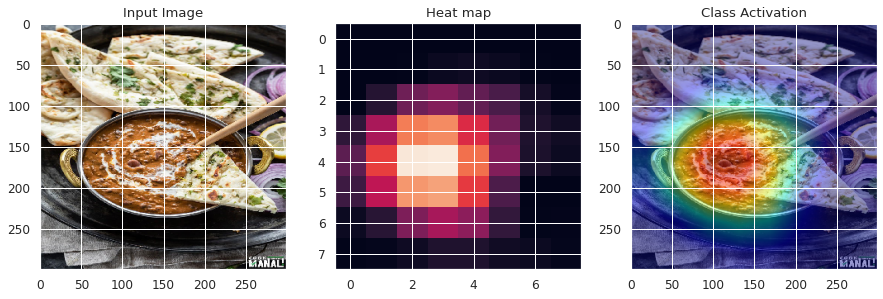

In [40]:
pred = get_attribution('download.jpg')

<hr>
<h2><div style="color:purple;text-align: center;font-weight:bold;">THANK YOU FOR BEARING WITH ME!</div></h2>
<hr>
<h2><center>If you liked this kernel or the yummy dataset, please consider upvoting.<br>Happy Kaggling.</center></h2>
<hr>
